# Clustering and Prediction of Airline Customer Satisfaction

In [1]:
# Load Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.cm import rainbow
import sklearn
import seaborn as sns
import warnings

#import pandas_profiling as pp

import statsmodels.api as sm
import statsmodels.tsa.api as smt
import warnings

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

from IPython.display import display
warnings.filterwarnings('ignore')

from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'
sns.set(style='whitegrid', palette='muted', font_scale=1.5)
rcParams['figure.figsize'] = 13, 8
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

np.random.seed(123)



In [37]:
#load dataset

data = pd.read_csv('train.csv', index_col=0)

#data = data.drop("id",axis=0)

In [32]:
data

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,94171,Female,disloyal Customer,23,Business travel,Eco,192,2,1,2,...,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,73097,Male,Loyal Customer,49,Business travel,Business,2347,4,4,4,...,5,5,5,5,5,5,4,0,0.0,satisfied
103901,68825,Male,disloyal Customer,30,Business travel,Business,1995,1,1,1,...,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,54173,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,1,...,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied


In [6]:
#data profiling
import pandas_profiling

#pip install pandas-profiling
#pandas_profiling.ProfileReport(data)


<AxesSubplot:xlabel='Customer Type', ylabel='Flight Distance'>

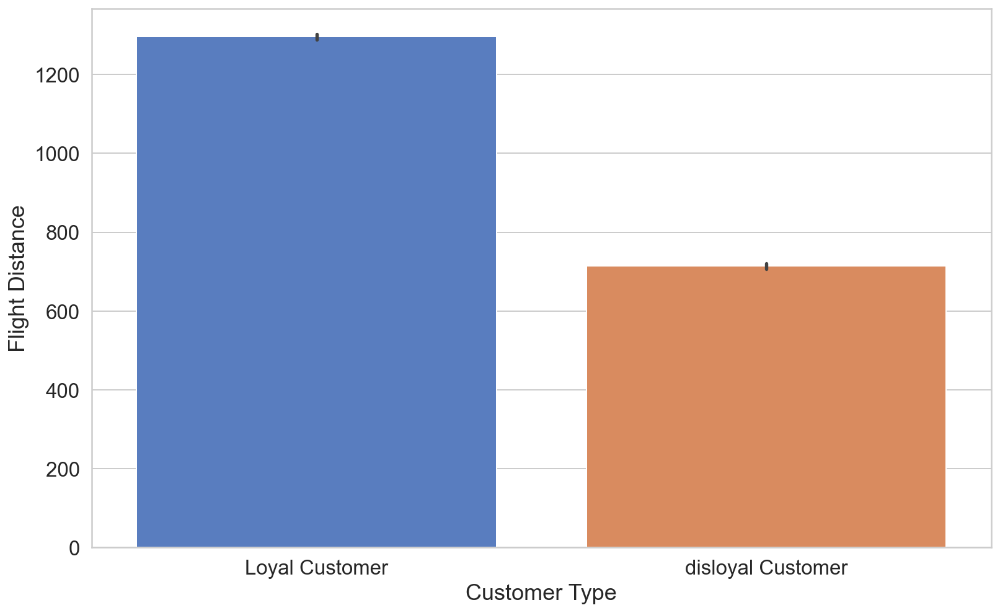

In [5]:
sns.barplot(x='Customer Type',y='Flight Distance',data=data)

<AxesSubplot:xlabel='Type of Travel', ylabel='Flight Distance'>

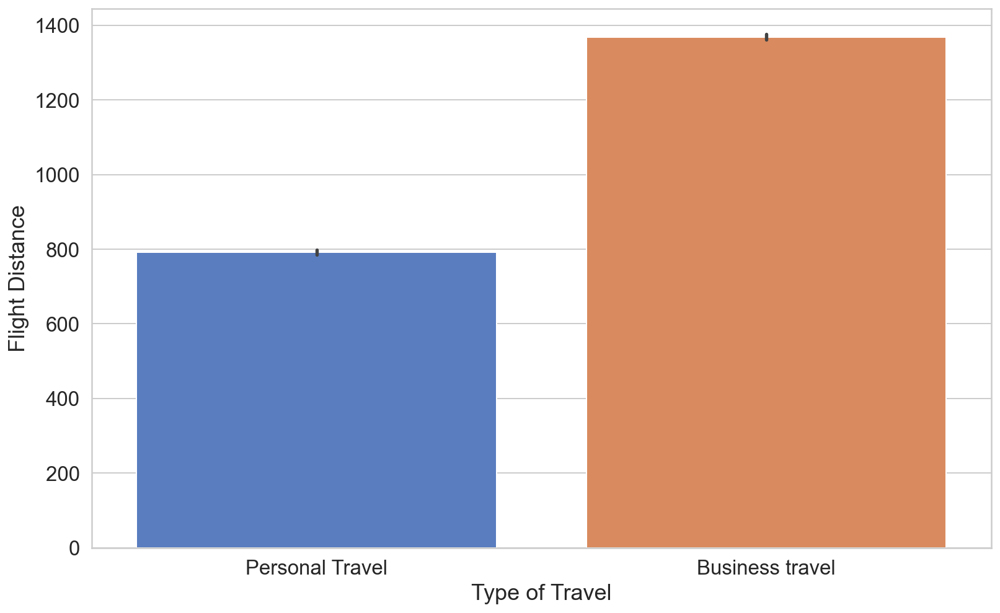

In [6]:
sns.barplot(x='Type of Travel',y='Flight Distance',data=data)

<AxesSubplot:xlabel='Flight Distance', ylabel='satisfaction'>

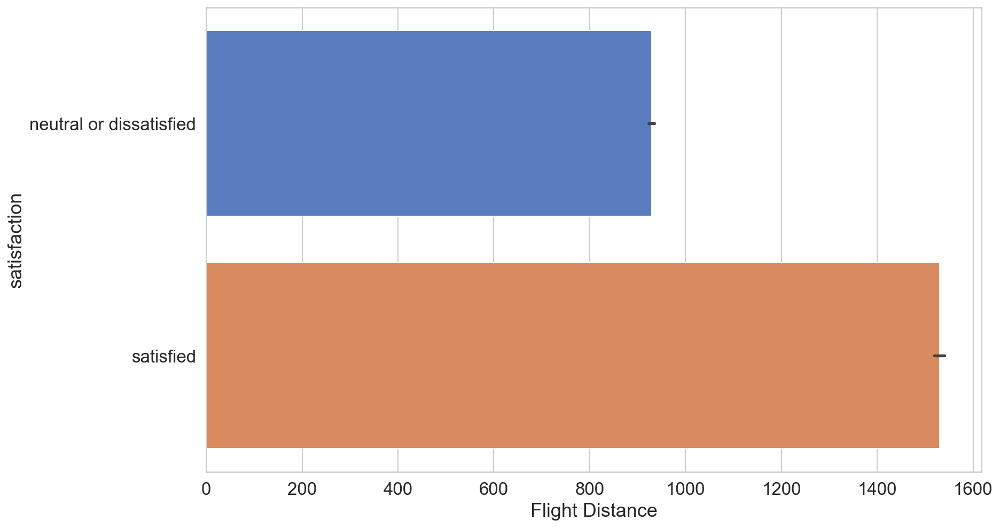

In [7]:
sns.barplot(x='Flight Distance',y='satisfaction',data=data)

<AxesSubplot:xlabel='satisfaction', ylabel='Flight Distance'>

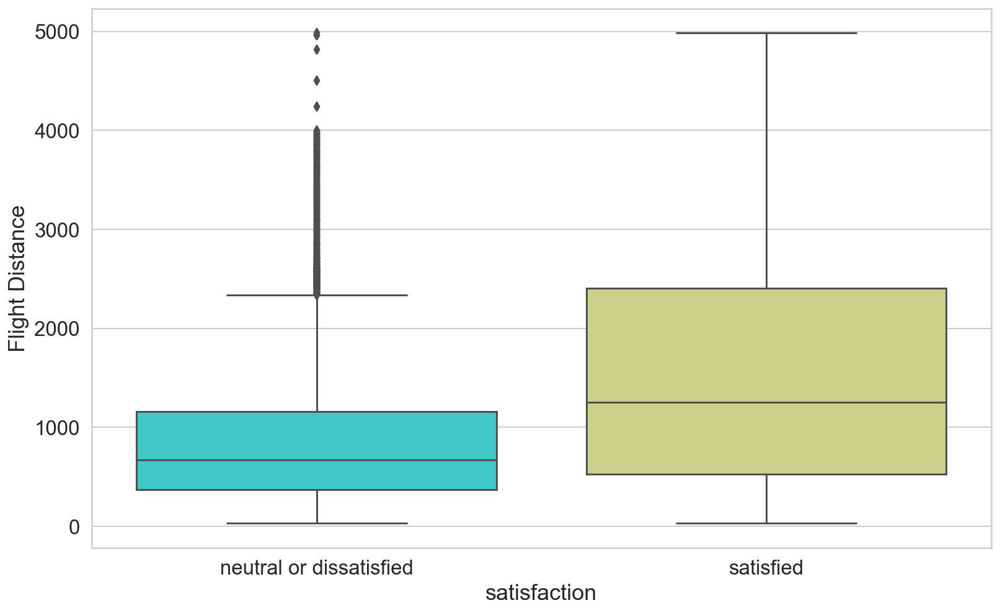

In [8]:
sns.boxplot(x='satisfaction',y='Flight Distance',data=data, palette='rainbow')

<AxesSubplot:xlabel='Departure Delay in Minutes', ylabel='Density'>

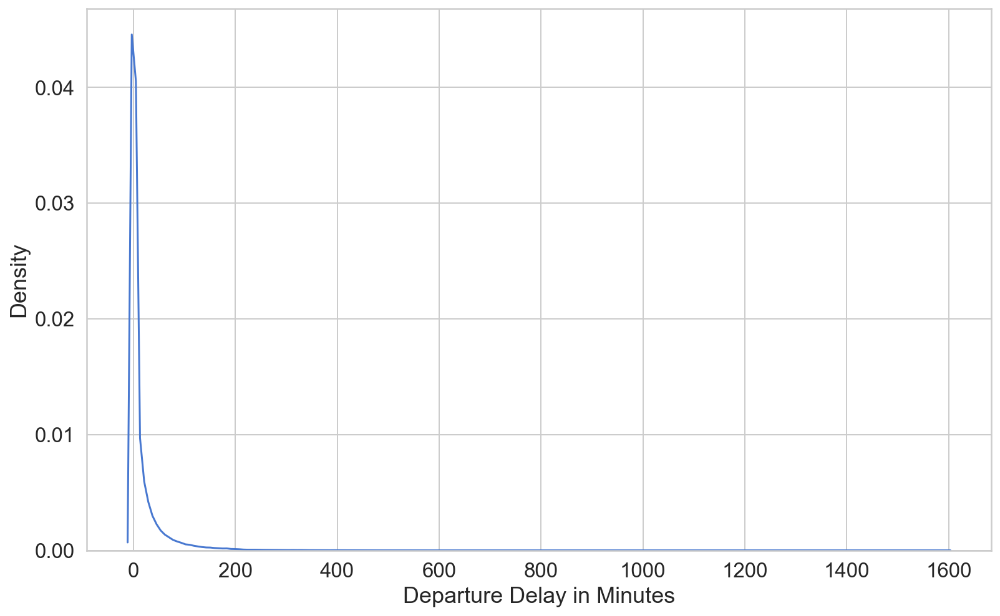

In [9]:
# Make default density plot
sns.kdeplot(data['Departure Delay in Minutes'])
#sns.plt.show()

In [10]:
data 

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,94171,Female,disloyal Customer,23,Business travel,Eco,192,2,1,2,...,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,73097,Male,Loyal Customer,49,Business travel,Business,2347,4,4,4,...,5,5,5,5,5,5,4,0,0.0,satisfied
103901,68825,Male,disloyal Customer,30,Business travel,Business,1995,1,1,1,...,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,54173,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,1,...,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied


In [11]:
#Making a copy of the dataset

df = data

### Missing Value Identification

In [38]:
 # Function to Identify Missing Values in all Features

def identify_NAs(data):
    
    NAs = []
    for column_name in data.columns:
        miss_count = data[column_name].isnull().sum(axis=0)
        miss_percent=miss_count/data.shape[0]
        NAs.append([column_name,miss_count,miss_percent*100])
        data_stats = pd.DataFrame.from_records( NAs, columns = ['Feature Name','Missing Count','Missing Percentage'])  
        data_stats = data_stats.sort_values('Missing Percentage',axis=0, ascending = False )
    return data_stats

data_stats = identify_NAs(data)

data_stats

,Feature Name,Missing Count,Missing Percentage
22,Arrival Delay in Minutes,310,0.298352
0,id,0,0.000000
1,Gender,0,0.000000
21,Departure Delay in Minutes,0,0.000000
20,Cleanliness,0,0.000000
19,Inflight service,0,0.000000
18,Checkin service,0,0.000000
17,Baggage handling,0,0.000000
16,Leg room service,0,0.000000
15,On-board service,0,0.000000


Text(0.5, 0, 'Feature Name')

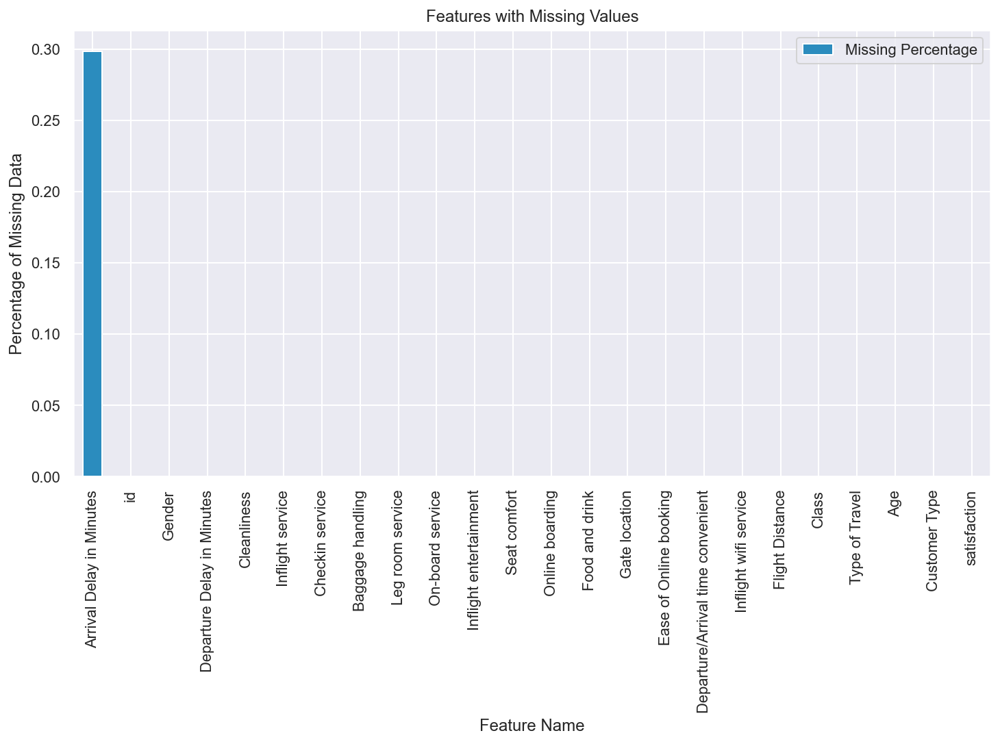

In [39]:
# Visualizing Missing Values
sns.set()
data_stats.plot.bar(x='Feature Name', y='Missing Percentage', figsize=(12,6), grid=True, color = '#2b8cbe')
plt.title('Features with Missing Values')
plt.ylabel('Percentage of Missing Data')
plt.xlabel('Feature Name')

In [40]:
# Mean Imputation
data['Arrival Delay in Minutes'].fillna(data['Arrival Delay in Minutes'].mean(), inplace=True)

In [41]:
# Checking for successful imputation
data.isna().sum()

id                                   0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Gate location                        0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
satisfaction                         0
dtype: int64

## Encoding Categorical Values

In [42]:
# Encode the categorical variables
for column in data.select_dtypes(include='object').columns:
    data[column] = data[column].astype('category').cat.codes

### Variable Correlations

In [43]:
corr = data.corr()
corr.style.background_gradient(cmap='coolwarm')

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
id,1.000000,-0.000606,0.000145,0.022857,0.000475,-0.104338,0.095544,-0.021276,-0.002110,0.014163,-0.000606,0.001063,0.055477,0.052903,0.002300,0.055241,0.044634,0.074940,0.079273,0.079346,0.024965,-0.019546,-0.037196,0.013734
Gender,-0.000606,1.000000,-0.031732,0.008928,0.006909,-0.012870,0.005828,0.008974,0.009142,0.006951,0.000333,0.005772,-0.042260,-0.026502,0.006117,0.008156,0.031798,0.037391,0.010563,0.039410,0.006505,0.002935,0.000395,0.012211
Customer Type,0.000145,-0.031732,1.000000,-0.281674,-0.308333,0.042638,-0.225200,-0.007543,-0.206869,-0.019509,0.006078,-0.059454,-0.189262,-0.159484,-0.109930,-0.056560,-0.047868,0.024723,-0.032177,0.022670,-0.083613,0.004036,0.004741,-0.187638
Age,0.022857,0.008928,-0.281674,1.000000,-0.048524,-0.117370,0.099461,0.017859,0.038125,0.024842,-0.001330,0.023000,0.208939,0.160277,0.076444,0.057594,0.040583,-0.047529,0.035482,-0.049427,0.053611,-0.010152,-0.012127,0.137167
Type of Travel,0.000475,0.006909,-0.308333,-0.048524,1.000000,0.487088,-0.267344,-0.105085,0.259763,-0.133511,-0.030700,-0.063439,-0.224803,-0.124399,-0.148199,-0.056543,-0.138803,-0.031321,0.016751,-0.022599,-0.079207,-0.005432,-0.005674,-0.449000
Class,-0.104338,-0.012870,0.042638,-0.117370,0.487088,1.000000,-0.427219,-0.023112,0.089922,-0.094329,-0.004488,-0.077042,-0.297062,-0.210158,-0.179028,-0.207748,-0.197321,-0.163998,-0.157112,-0.158604,-0.125988,0.010281,0.014678,-0.449321
Flight Distance,0.095544,0.005828,-0.225200,0.099461,-0.267344,-0.427219,1.000000,0.007131,-0.020043,0.065717,0.004793,0.056994,0.214869,0.157333,0.128740,0.109526,0.133916,0.063184,0.073072,0.057540,0.093149,0.002158,-0.002423,0.298780
Inflight wifi service,-0.021276,0.008974,-0.007543,0.017859,-0.105085,-0.023112,0.007131,1.000000,0.343845,0.715856,0.336248,0.134718,0.456970,0.122658,0.209321,0.121500,0.160473,0.120923,0.043193,0.110441,0.132698,-0.017402,-0.019067,0.284245
Departure/Arrival time convenient,-0.002110,0.009142,-0.206869,0.038125,0.259763,0.089922,-0.020043,0.343845,1.000000,0.436961,0.444757,0.004906,0.070119,0.011344,-0.004861,0.068882,0.012441,0.072126,0.093333,0.073318,0.014292,0.001005,-0.000863,-0.051601
Ease of Online booking,0.014163,0.006951,-0.019509,0.024842,-0.133511,-0.094329,0.065717,0.715856,0.436961,1.000000,0.458655,0.031873,0.404074,0.030014,0.047032,0.038833,0.107601,0.038762,0.011081,0.035272,0.016179,-0.006371,-0.007972,0.171705


<b>Note:</b> Correlation matrix reveal high correlation between delay in minutes variables. Clustering is better done without much correlation between variables. Thus removing one of them as a result.

### Resolving Multicorrelated Features.

In [45]:
# Calculate the correlation matrix
corr = data.corr()

# Identify the highly correlated variables
highly_correlated_variables = corr.loc[(corr > 0.95) | (corr < -0.95), :]

# Print the highly correlated variables
print(highly_correlated_variables)

# Remove the highly correlated variables
#data = data.drop(columns=highly_correlated_variables.columns, axis=1)

ValueError: Cannot index with multidimensional key

In [17]:
# Dropping dichotomous and multicorrelated variables for better clustering outcome

data = data.drop(['Departure Delay in Minutes'], axis=1)

In [28]:

# Calculate the correlation matrix
corr = data.corr()

# Select the upper triangle
upper_triangle = np.triu(corr)

# Identify the highly correlated variables
highly_correlated_variables = np.where(upper_triangle > 0.95)[0]

# Remove the highly correlated variables
df = data.drop(columns=highly_correlated_variables, axis=1)

# Print the cleaned data
print(df)

KeyError: '[0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 21 22 23] not found in axis'

### Encoding Categorical Values

The use <b>OrdinalEncoder</b> and <b>OneHotEncoder</b> which is the correct approach to use for encoding target values.

In [18]:
obj_data = data.select_dtypes(include=['object']).copy()
obj_data.head()

,Gender,Customer Type,Type of Travel,Class,satisfaction
0,Male,Loyal Customer,Personal Travel,Eco Plus,neutral or dissatisfied
1,Male,disloyal Customer,Business travel,Business,neutral or dissatisfied
2,Female,Loyal Customer,Business travel,Business,satisfied
3,Female,Loyal Customer,Business travel,Business,neutral or dissatisfied
4,Male,Loyal Customer,Business travel,Business,satisfied


In [19]:
from sklearn.preprocessing import OrdinalEncoder

ord_enc = OrdinalEncoder()
obj_df["type"] = ord_enc.fit_transform(obj_df[["Class"]])
obj_df[["Class", "type"]].head(11)

NameError: name 'obj_df' is not defined

In [ ]:
#View current data types

print (data.dtypes)

In [ ]:
data

In [ ]:
# Only consider these three variables for the conversion
data['Gender'] = data['Gender'].astype(str).astype(int)
#data['Gender'] = data['Gender'].astype(np.int64)
data['Customer Type'] = data['Customer Type'].astype(np.int64)
data['Class'] = data['Class'].astype(np.int64)
data['Type of Travel'] = data['Type of Travel'].astype(np.int64)

# Confirm datatype conversion

print (data2.dtypes)

## Unsupervised Clustering

### 1. K Means Clustering

In [9]:
from sklearn.cluster import KMeans

clusters = []

for i in range(1, 11):
    km = KMeans(n_clusters=i).fit(data_en)
    clusters.append(km.inertia_)
    
fig, ax = plt.subplots(figsize=(12, 8))
sns.lineplot(x=list(range(1, 11)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Clusters')
ax.set_ylabel('Inertia')

# Annotate Elbow Arrows
ax.annotate('Optimal Elbow Point', xy=(3, 470000), xytext=(3, 640000), xycoords='data',          
             arrowprops=dict(arrowstyle='->', connectionstyle='arc3', color='yellow', lw=2))

ax.annotate('Possible Elbow Point', xy=(5, 330000), xytext=(5, 510000), xycoords='data',          
             arrowprops=dict(arrowstyle='->', connectionstyle='arc3', color='red', lw=2))

plt.show()


NameError: name 'data_en' is not defined

## Dummy Encoding

In [ ]:
#  Dummy encoding of the data
data_en=pd.get_dummies(data=data,drop_first=True)
data_en

# Modeling with a Cross-validated Pipeline
+ Using scikit-learn (rather than pandas) for preprocessing

In [100]:
import pandas as pd
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_score

In [101]:
df = pd.read_csv("train.csv", index_col=0)

#Renaming certain variables 
df.rename(columns={"Customer Type":"Customer_Type",
                          "Type of Travel":"Type_Travel",
                          "Flight Distance":"Flight_Distance",
                          "Inflight wifi service":"Inflight_Wifi",
                          "Departure/Arrival time convenient":"DA_Convinient",
                          "Ease of Online booking":"Online_Booking",
                          "Gate location":"Gate_Location",
                          "Food and drink":"Food_Drink",
                          "Seat comfort":"Seat_Comfort",
                          "Inflight entertainment":"Inflight_Entertainment",
                          "On-board service":"Onboard_Service ",
                          "Leg room service":"Leg_Room_Service",
                          "Baggage handling":"Baggage_Handling",
                          "Checkin service":"Checkin_Service",
                          "Inflight service":"Inflight_Service",
                          "Arrival Delay in Minutes":"Arrival_Delay",
                          "Departure Delay in Minutes":"Departure_Delay",
                          "satisfaction":"Satisfaction"}, inplace=True)

df['Arrival_Delay'].fillna(df['Arrival_Delay'].mean(), inplace=True)

X = df.drop(['id','Satisfaction'], axis=1)

y = df.Satisfaction



In [106]:
column_trans = make_column_transformer(
    (OneHotEncoder(), ['Gender','Customer_Type', 'Type_Travel','Class']),
     remainder='passthrough')

logreg = LogisticRegression(solver='lbfgs', max_iter=2000)

In [107]:
pipe = make_pipeline(column_trans, logreg)

In [108]:
cross_val_score(pipe, X, y, cv=5, scoring='accuracy').mean()
#ACCURACY: 87.5%

0.875134780377741

In [97]:
X_new = X.sample(5, random_state=99)

In [98]:
pipe.fit(X, y)
pipe.predict(X_new)

array(['satisfied', 'satisfied', 'satisfied', 'neutral or dissatisfied',
       'satisfied'], dtype=object)

In [7]:
df

NameError: name 'df' is not defined

In [8]:
data

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,94171,Female,disloyal Customer,23,Business travel,Eco,192,2,1,2,...,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,73097,Male,Loyal Customer,49,Business travel,Business,2347,4,4,4,...,5,5,5,5,5,5,4,0,0.0,satisfied
103901,68825,Male,disloyal Customer,30,Business travel,Business,1995,1,1,1,...,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,54173,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,1,...,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied
